# Load Libraries

In [5]:
!pip install scikit-dimension
!pip install Cython
!pip install Ripser
!pip install umap-learn
!pip install giotto-tda
!pip install neurodsp
!pip install emd

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
   ---------------------------------------- 0.0/85.3 kB ? eta -:--:--
   -------------------------------------- - 81.9/85.3 kB 2.3 MB/s eta 0:00:01
   ---------------------------------------- 85.3/85.3 kB 2.4 MB/s eta 0:00:00
   ---------------------------------------- 0.0/55.5 kB ? eta -:--:--
   ---------------------------------------- 55.5/55.5 kB ? eta 0:00:00
   ---------------------------------------- 0.0/237.3 kB ? eta -:--:--
   -------------

In [1]:
# Load required libraries
import numpy as np
from scipy.io import loadmat
from scipy.signal import hilbert
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
import seaborn as sns
from neurodsp.filt import filter_signal, filter_signal_fir, design_fir_filter
import emd
import pandas as pd
from sklearn.preprocessing import Normalizer
from tqdm import tqdm
import plotly.express as px
from sklearn.decomposition import PCA, FastICA
from sklearn.preprocessing import StandardScaler
import copy
import umap.umap_ as umap
import skdim
from scipy.spatial import cKDTree
from gtda.time_series import SingleTakensEmbedding
from gtda.plotting import plot_point_cloud

# Import custom functions
from functions import *

sns.set(style='white', context='notebook')

# OS_basic_13_CN data

In [3]:
path_to_data = './data/OS_basic_13_CN/'
data_file = 'Cleaned_Trial1_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-13_11-24-48_post_trial1-states.mat'
pfc_data1, sleep_scoring1 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial2_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-13_12-15-25_post_trial2-states.mat'
pfc_data2, sleep_scoring2 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial3_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-13_13-05-57_post_trial3-states.mat'
pfc_data3, sleep_scoring3 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial4_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-13_13-56-29_post_trial4-states.mat'
pfc_data4, sleep_scoring4 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial5_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-13_14-53-54_post_trial5-states.mat'
pfc_data5, sleep_scoring5 = load_mat_data(path_to_data, data_file, states_file)

In [6]:
OS_delta_cycle_data_trial1 = get_delta_cycles(pfc_data1, sleep_scoring1, fs=2500)
OS_delta_cycle_data_trial2 = get_delta_cycles(pfc_data2, sleep_scoring2, fs=2500)
OS_delta_cycle_data_trial3 = get_delta_cycles(pfc_data3, sleep_scoring3, fs=2500)
OS_delta_cycle_data_trial4 = get_delta_cycles(pfc_data4, sleep_scoring4, fs=2500)
OS_delta_cycle_data_trial5 = get_delta_cycles(pfc_data5, sleep_scoring5, fs=2500)

 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'


In [117]:
metrics1 = OS_delta_cycle_data_trial1['cycles'].get_metric_dataframe()
metrics2 = OS_delta_cycle_data_trial2['cycles'].get_metric_dataframe()
metrics3 = OS_delta_cycle_data_trial3['cycles'].get_metric_dataframe()
metrics4 = OS_delta_cycle_data_trial4['cycles'].get_metric_dataframe()
metrics5 = OS_delta_cycle_data_trial5['cycles'].get_metric_dataframe()

OS_all_trials_metrics = pd.concat([metrics1, metrics2, metrics3, metrics4, metrics5])
# all_trials_metrics = metrics5

trough = 100
peak = 0
delta_peak = 40

peak_thresh = np.percentile(OS_all_trials_metrics['peak_values'], peak)
trough_thresh = np.percentile(OS_all_trials_metrics['trough_values'], trough)
delta_peak_thresh = np.percentile(OS_all_trials_metrics['peak_values'], delta_peak)

lo_freq_duration = OS_delta_cycle_data_trial5['fs']/0.1
hi_freq_duration = OS_delta_cycle_data_trial5['fs']/4

In [118]:
# Apply conditions to get good cycles
conditions_all_cycles = ['is_good==1',
              f'duration_samples<{lo_freq_duration}',
              f'duration_samples>{hi_freq_duration}',
              f'trough_values<={trough_thresh}']

OS_all_cycles_trial1 = get_cycles_with_conditions(OS_delta_cycle_data_trial1['cycles'], conditions_all_cycles)
OS_all_cycles_trial2 = get_cycles_with_conditions(OS_delta_cycle_data_trial2['cycles'], conditions_all_cycles)
OS_all_cycles_trial3 = get_cycles_with_conditions(OS_delta_cycle_data_trial3['cycles'], conditions_all_cycles)
OS_all_cycles_trial4 = get_cycles_with_conditions(OS_delta_cycle_data_trial4['cycles'], conditions_all_cycles)
OS_all_cycles_trial5 = get_cycles_with_conditions(OS_delta_cycle_data_trial5['cycles'], conditions_all_cycles)

In [120]:
OS_all_waveforms_trial1, _ = emd.cycles.phase_align(OS_delta_cycle_data_trial1['IP'], OS_delta_cycle_data_trial1['nrem_filtered_data'],
                                                            cycles=OS_all_cycles_trial1.iterate(through='subset'), npoints=100)
OS_all_waveforms_trial2, _ = emd.cycles.phase_align(OS_delta_cycle_data_trial2['IP'], OS_delta_cycle_data_trial2['nrem_filtered_data'],
                                                            cycles=OS_all_cycles_trial2.iterate(through='subset'), npoints=100)
OS_all_waveforms_trial3, _ = emd.cycles.phase_align(OS_delta_cycle_data_trial3['IP'], OS_delta_cycle_data_trial3['nrem_filtered_data'],
                                                            cycles=OS_all_cycles_trial3.iterate(through='subset'), npoints=100)
OS_all_waveforms_trial4, _ = emd.cycles.phase_align(OS_delta_cycle_data_trial4['IP'], OS_delta_cycle_data_trial4['nrem_filtered_data'],
                                                            cycles=OS_all_cycles_trial4.iterate(through='subset'), npoints=100)
OS_all_waveforms_trial5, _ = emd.cycles.phase_align(OS_delta_cycle_data_trial5['IP'], OS_delta_cycle_data_trial5['nrem_filtered_data'],
                                                            cycles=OS_all_cycles_trial5.iterate(through='subset'), npoints=100)

OS_all_waveforms_trial1 = OS_all_waveforms_trial1.T
OS_all_waveforms_trial2 = OS_all_waveforms_trial2.T
OS_all_waveforms_trial3 = OS_all_waveforms_trial3.T
OS_all_waveforms_trial4 = OS_all_waveforms_trial4.T
OS_all_waveforms_trial5 = OS_all_waveforms_trial5.T

OS_all_waveforms = np.vstack((OS_all_waveforms_trial1,
                              OS_all_waveforms_trial2,
                              OS_all_waveforms_trial3,
                              OS_all_waveforms_trial4,
                              OS_all_waveforms_trial5))

 Checking phase_align inputs - trimming singleton from input 'ip'
 Checking phase_align inputs - trimming singleton from input 'ip'
 Checking phase_align inputs - trimming singleton from input 'ip'
 Checking phase_align inputs - trimming singleton from input 'ip'
 Checking phase_align inputs - trimming singleton from input 'ip'


In [129]:
def fun(row, cycle_vector, fs):
    return (np.where(cycle_vector == row.name)[0][0])/fs

In [130]:
metrics = OS_all_cycles_trial1.get_metric_dataframe(subset=True)
cycle_vector = get_masked_cycles(OS_delta_cycle_data_trial1['IP'], OS_all_cycles_trial1)
metrics['cycle_position'] = metrics.apply(fun, cycle_vector=cycle_vector, fs=2500, axis=1)

In [137]:
OS_trial1 = OS_all_cycles_trial1.get_metric_dataframe(subset=True)
cycle_vector = get_masked_cycles(OS_delta_cycle_data_trial1['IP'], OS_all_cycles_trial1)
OS_trial1['cycle_position'] = OS_trial1.apply(fun, cycle_vector=cycle_vector, fs=2500, axis=1)

OS_trial2 = OS_all_cycles_trial2.get_metric_dataframe(subset=True)
cycle_vector = get_masked_cycles(OS_delta_cycle_data_trial2['IP'], OS_all_cycles_trial2)
OS_trial2['cycle_position'] = OS_trial2.apply(fun, cycle_vector=cycle_vector, fs=2500, axis=1)

OS_trial3 = OS_all_cycles_trial3.get_metric_dataframe(subset=True)
cycle_vector = get_masked_cycles(OS_delta_cycle_data_trial3['IP'], OS_all_cycles_trial3)
OS_trial3['cycle_position'] = OS_trial3.apply(fun, cycle_vector=cycle_vector, fs=2500, axis=1)

OS_trial4 = OS_all_cycles_trial4.get_metric_dataframe(subset=True)
cycle_vector = get_masked_cycles(OS_delta_cycle_data_trial4['IP'], OS_all_cycles_trial4)
OS_trial4['cycle_position'] = OS_trial4.apply(fun, cycle_vector=cycle_vector, fs=2500, axis=1)

OS_trial5 = OS_all_cycles_trial5.get_metric_dataframe(subset=True)
cycle_vector = get_masked_cycles(OS_delta_cycle_data_trial5['IP'], OS_all_cycles_trial5)
OS_trial5['cycle_position'] = OS_trial5.apply(fun, cycle_vector=cycle_vector, fs=2500, axis=1)

OS_all_trials = pd.concat([OS_trial1, OS_trial2, OS_trial3, OS_trial4, OS_trial5])
OS_all_trials.columns = OS_all_trials.columns.astype('str')
OS_all_trials

,index,is_good,duration_samples,peak2trough,asc2desc,max_amp,trough_values,peak_values,mean_if,max_if,range_if,trough_position,peak_position,chain_ind,cycle_position
0,2,1,868,0.369040,0.556698,214.858695,-195.344148,119.410062,2.879093,5.984041,4.857771,547,162,0,1.6996
1,6,1,1179,0.533293,0.491466,284.984836,-108.089937,221.673201,2.119849,2.806335,1.160761,882,282,1,2.7752
2,7,1,763,0.291400,0.471033,217.200945,-136.589249,25.900409,3.276697,40.551131,38.952637,517,113,1,3.2468
3,10,1,1572,0.623010,0.586205,168.938174,-103.271939,82.793636,1.590402,3.051785,2.633561,1293,642,2,3.9712
4,12,1,910,0.635798,0.543020,271.747838,-109.023660,271.668589,2.747613,4.537327,2.902072,731,315,3,5.3604
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4427,7595,1,707,0.676814,0.488349,192.441530,-35.106093,155.192413,3.534930,7.955688,5.882428,586,224,1585,3211.4520
4428,7596,1,671,0.728662,0.454695,77.349156,-6.787020,69.095067,3.726901,13.660338,11.416041,572,206,1585,3211.7348
4429,7601,1,869,0.341647,0.517461,140.926430,-133.206529,25.077379,2.875533,5.179041,3.240707,593,173,1586,3213.6880
4430,7602,1,962,0.241397,0.592671,132.660822,-97.217720,30.825942,2.598362,58.760240,58.217126,504,113,1586,3214.0356


In [138]:
# metrics = OS_all_cycles_trial1.get_metric_dataframe(subset=True)
# OS_trial1 = pd.concat([metrics, pd.DataFrame(OS_all_waveforms_trial1)], axis=1)

# metrics = OS_all_cycles_trial2.get_metric_dataframe(subset=True)
# OS_trial2 = pd.concat([metrics, pd.DataFrame(OS_all_waveforms_trial2)], axis=1)

# metrics = OS_all_cycles_trial3.get_metric_dataframe(subset=True)
# OS_trial3 = pd.concat([metrics, pd.DataFrame(OS_all_waveforms_trial3)], axis=1)

# metrics = OS_all_cycles_trial4.get_metric_dataframe(subset=True)
# OS_trial4 = pd.concat([metrics, pd.DataFrame(OS_all_waveforms_trial4)], axis=1)

# metrics = OS_all_cycles_trial5.get_metric_dataframe(subset=True)
# OS_trial5 = pd.concat([metrics, pd.DataFrame(OS_all_waveforms_trial5)], axis=1)

# OS_all_trials = pd.concat([OS_trial1, OS_trial2, OS_trial3, OS_trial4, OS_trial5])
# OS_all_trials.columns = OS_all_trials.columns.astype('str')
# OS_all_trials

## Intrinsic Dimension Estimation

In [54]:
danco = skdim.id.DANCo().fit(OS_all_waveforms)
danco.dimension_

5.946354023124081

In [55]:
lpca = skdim.id.lPCA().fit_pw(OS_all_waveforms,
                              n_neighbors = 100,
                              n_jobs = 1)
np.mean(lpca.dimension_pw_)

4.060211881453668

In [10]:
def abids(X,k):
    search_struct = cKDTree(X)
    return np.array([abid(X,k,x,search_struct) for x in tqdm(X,desc="abids",leave=False)])


def abid(X,k,x,search_struct,offset=1):
    neighbor_norms, neighbors = search_struct.query(x,k+offset)
    neighbors = X[neighbors[offset:]] - x
    normed_neighbors = neighbors / neighbor_norms[offset:,None]
    # Original publication version that computes all cosines
    # coss = normed_neighbors.dot(normed_neighbors.T)
    # return np.mean(np.square(coss))**-1
    # Using another product to get the same values with less effort
    para_coss = normed_neighbors.T.dot(normed_neighbors)
    return k**2 / np.sum(np.square(para_coss))

ID = np.round(np.nanmean(abids(OS_all_waveforms, 50)))
ID

3.0

## UMAP

In [153]:
umap_embedder = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3, metric='euclidean')
embedding = umap_embedder.fit(OS_all_waveforms)
emb = embedding.embedding_

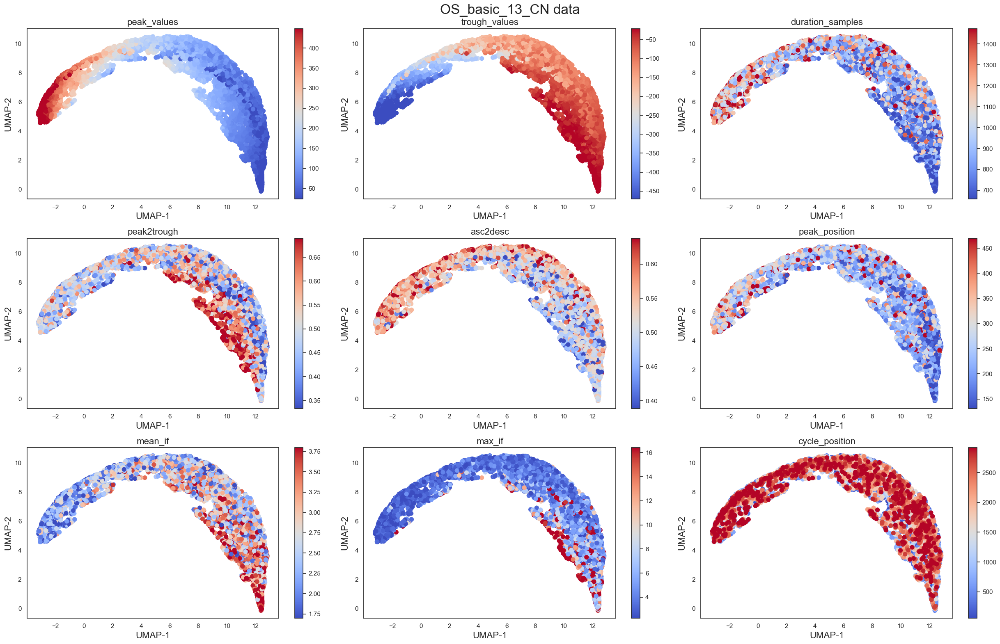

In [159]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','cycle_position']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,1], c=OS_all_trials[feature],
            vmin=np.percentile(OS_all_trials[feature],5),
            vmax=np.percentile(OS_all_trials[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-2', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("OS_basic_13_CN data", fontsize=24);
f.tight_layout()
plt.savefig('OS_basic_13_CN_UMAP1&2.jpg')
plt.savefig('OS_basic_13_CN_UMAP1&2.svg')

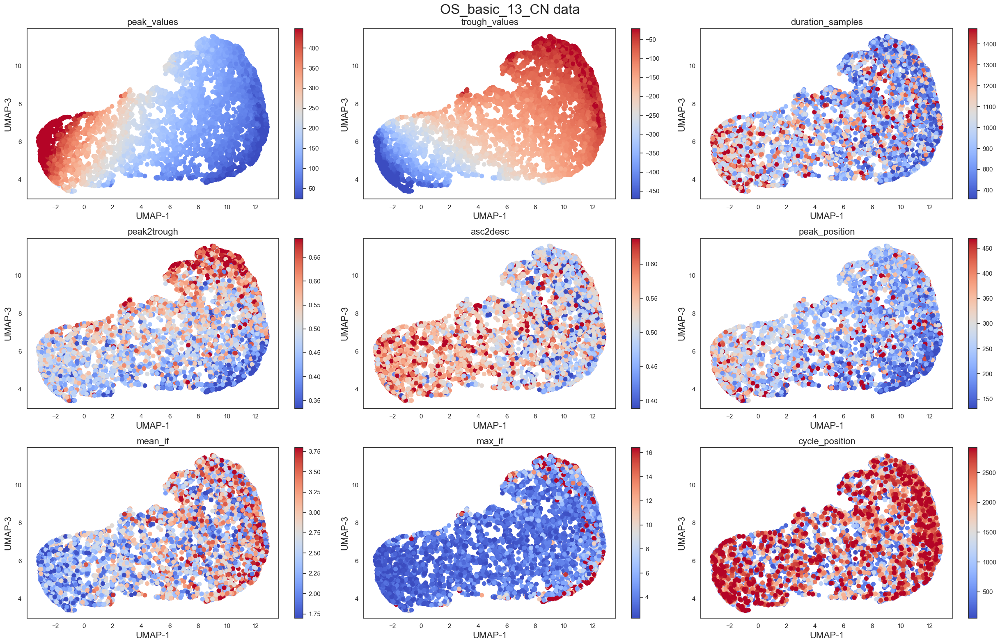

In [160]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','cycle_position']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,2], c=OS_all_trials[feature],
            vmin=np.percentile(OS_all_trials[feature],5),
            vmax=np.percentile(OS_all_trials[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-3', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("OS_basic_13_CN data", fontsize=24);
f.tight_layout()
plt.savefig('OS_basic_13_CN_UMAP1&3.jpg')
plt.savefig('OS_basic_13_CN_UMAP1&3.svg')

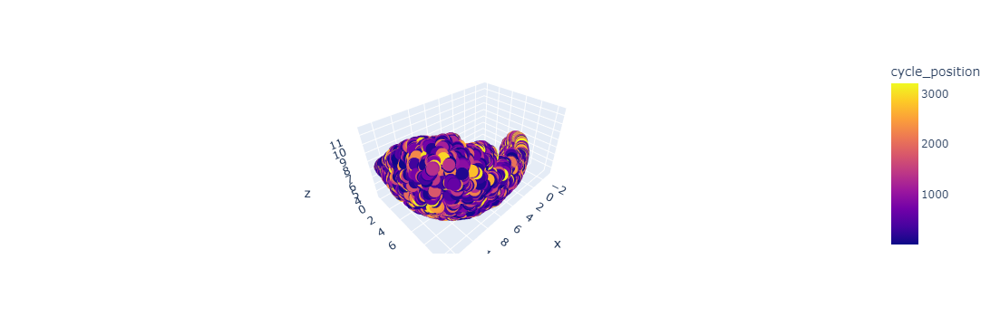

In [161]:
fig = px.scatter_3d(x=emb[:,0], y=emb[:,1], z=emb[:,2],
              color=OS_all_trials['cycle_position'])
fig.update_layout(coloraxis_colorbar_title_text = 'cycle_position')

fig.show()

# CBD_5_SD4 dataset

In [181]:
path_to_data = './data/CBD_5_SD4/'
data_file = 'Cleaned_Trial1_PFC_100_CH12_0.continuous.mat'
states_file = '2021-07-16_11-23-25_posttrial1-states_ES.mat'
pfc_data1, sleep_scoring1 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial2_PFC_100_CH12_0.continuous.mat'
states_file = '2021-07-16_12-13-39_posttrial2-states_ES.mat'
pfc_data2, sleep_scoring2 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial3_PFC_100_CH12_0.continuous.mat'
states_file = '2021-07-16_13-09-26_posttrial3-states_ES.mat'
pfc_data3, sleep_scoring3 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial4_PFC_100_CH12_0.continuous.mat'
states_file = '2021-07-16_13-59-43_posttrial4-states_ES.mat'
pfc_data4, sleep_scoring4 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial5_PFC_100_CH12_0.continuous.mat'
states_file = '2021-07-16_14-49-56_posttrial5-states_ES.mat'
pfc_data5, sleep_scoring5 = load_mat_data(path_to_data, data_file, states_file)

In [182]:
CBD_delta_cycle_data_trial1 = get_delta_cycles(pfc_data1, sleep_scoring1, fs=2500)
CBD_delta_cycle_data_trial2 = get_delta_cycles(pfc_data2, sleep_scoring2, fs=2500)
CBD_delta_cycle_data_trial3 = get_delta_cycles(pfc_data3, sleep_scoring3, fs=2500)
CBD_delta_cycle_data_trial4 = get_delta_cycles(pfc_data4, sleep_scoring4, fs=2500)
CBD_delta_cycle_data_trial5 = get_delta_cycles(pfc_data5, sleep_scoring5, fs=2500)

 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'


In [183]:
metrics1 = CBD_delta_cycle_data_trial1['cycles'].get_metric_dataframe()
metrics2 = CBD_delta_cycle_data_trial2['cycles'].get_metric_dataframe()
metrics3 = CBD_delta_cycle_data_trial3['cycles'].get_metric_dataframe()
metrics4 = CBD_delta_cycle_data_trial4['cycles'].get_metric_dataframe()
metrics5 = CBD_delta_cycle_data_trial5['cycles'].get_metric_dataframe()

CBD_all_trials_metrics = pd.concat([metrics1, metrics2, metrics3, metrics4, metrics5])
# all_trials_metrics = metrics5

trough = 100
peak = 80
delta_peak = 40

peak_thresh = np.percentile(CBD_all_trials_metrics['peak_values'], peak)
trough_thresh = np.percentile(CBD_all_trials_metrics['trough_values'], trough)
delta_peak_thresh = np.percentile(CBD_all_trials_metrics['peak_values'], delta_peak)

lo_freq_duration = CBD_delta_cycle_data_trial5['fs']/0.1
hi_freq_duration = CBD_delta_cycle_data_trial5['fs']/4

In [184]:
# Apply conditions to get good cycles
conditions_all_cycles = ['is_good==1',
              f'duration_samples<{lo_freq_duration}',
              f'duration_samples>{hi_freq_duration}',
              f'trough_values<={trough_thresh}']

CBD_all_cycles_trial1 = get_cycles_with_conditions(CBD_delta_cycle_data_trial1['cycles'], conditions_all_cycles)
CBD_all_cycles_trial2 = get_cycles_with_conditions(CBD_delta_cycle_data_trial2['cycles'], conditions_all_cycles)
CBD_all_cycles_trial3 = get_cycles_with_conditions(CBD_delta_cycle_data_trial3['cycles'], conditions_all_cycles)
CBD_all_cycles_trial4 = get_cycles_with_conditions(CBD_delta_cycle_data_trial4['cycles'], conditions_all_cycles)
CBD_all_cycles_trial5 = get_cycles_with_conditions(CBD_delta_cycle_data_trial5['cycles'], conditions_all_cycles)

In [195]:
CBD_all_waveforms_trial1, _ = emd.cycles.phase_align(CBD_delta_cycle_data_trial1['IP'], CBD_delta_cycle_data_trial1['nrem_filtered_data'],
                                                            cycles=CBD_all_cycles_trial1.iterate(through='subset'), npoints=100)
CBD_all_waveforms_trial2, _ = emd.cycles.phase_align(CBD_delta_cycle_data_trial2['IP'], CBD_delta_cycle_data_trial2['nrem_filtered_data'],
                                                            cycles=CBD_all_cycles_trial2.iterate(through='subset'), npoints=100)
CBD_all_waveforms_trial3, _ = emd.cycles.phase_align(CBD_delta_cycle_data_trial3['IP'], CBD_delta_cycle_data_trial3['nrem_filtered_data'],
                                                            cycles=CBD_all_cycles_trial3.iterate(through='subset'), npoints=100)
CBD_all_waveforms_trial4, _ = emd.cycles.phase_align(CBD_delta_cycle_data_trial4['IP'], CBD_delta_cycle_data_trial4['nrem_filtered_data'],
                                                            cycles=CBD_all_cycles_trial4.iterate(through='subset'), npoints=100)
CBD_all_waveforms_trial5, _ = emd.cycles.phase_align(CBD_delta_cycle_data_trial5['IP'], CBD_delta_cycle_data_trial5['nrem_filtered_data'],
                                                            cycles=CBD_all_cycles_trial5.iterate(through='subset'), npoints=100)

CBD_all_waveforms_trial1 = CBD_all_waveforms_trial1.T
CBD_all_waveforms_trial2 = CBD_all_waveforms_trial2.T
CBD_all_waveforms_trial3 = CBD_all_waveforms_trial3.T
CBD_all_waveforms_trial4 = CBD_all_waveforms_trial4.T
CBD_all_waveforms_trial5 = CBD_all_waveforms_trial5.T

In [186]:
metrics = CBD_all_cycles_trial1.get_metric_dataframe(subset=True)
CBD_trial1 = pd.concat([metrics, pd.DataFrame(CBD_all_waveforms_trial1)], axis=1)

metrics = CBD_all_cycles_trial2.get_metric_dataframe(subset=True)
CBD_trial2 = pd.concat([metrics, pd.DataFrame(CBD_all_waveforms_trial2)], axis=1)

metrics = CBD_all_cycles_trial3.get_metric_dataframe(subset=True)
CBD_trial3 = pd.concat([metrics, pd.DataFrame(CBD_all_waveforms_trial3)], axis=1)

metrics = CBD_all_cycles_trial4.get_metric_dataframe(subset=True)
CBD_trial4 = pd.concat([metrics, pd.DataFrame(CBD_all_waveforms_trial4)], axis=1)

metrics = CBD_all_cycles_trial5.get_metric_dataframe(subset=True)
CBD_trial5 = pd.concat([metrics, pd.DataFrame(CBD_all_waveforms_trial5)], axis=1)

CBD_all_trials = pd.concat([CBD_trial1, CBD_trial2, CBD_trial3, CBD_trial4, CBD_trial5])
CBD_all_trials.columns = CBD_all_trials.columns.astype('str')
CBD_all_trials

,index,is_good,duration_samples,peak2trough,asc2desc,max_amp,trough_values,peak_values,mean_if,max_if,...,1709,1710,1711,1712,1713,1714,1715,1716,1717,1718
0,2,1,1087,0.463236,0.571837,357.297225,-314.578970,308.878241,2.300458,2.905585,...,4.881576,14.000717,7.571509,6.604220,3.819872,4.971168,9.063736,4.993911,2.221334,2.089865
1,4,1,651,0.562710,0.480593,55.801665,-29.884647,44.970388,3.841329,5.491717,...,13.948920,42.149247,23.613528,19.450599,12.043968,15.156891,27.706690,16.036653,7.243090,5.857245
2,6,1,712,0.436491,0.514548,111.995419,-88.112603,71.711225,3.506781,10.607901,...,22.049428,70.377558,40.707012,31.759736,21.042782,25.635340,46.825558,28.392554,13.058956,9.070508
3,7,1,695,0.315151,0.476293,118.739504,-116.311111,29.654820,3.601633,14.844641,...,29.516673,98.543261,58.679311,43.471387,30.796358,36.361290,66.172176,41.941908,19.676678,11.737868
4,9,1,802,0.433666,0.516196,113.674621,-106.889728,76.061983,3.116700,4.301557,...,36.987518,126.502723,77.360511,54.529493,41.271576,47.287985,85.504674,56.558862,27.090477,13.881981
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5327,10213,1,1702,0.303847,0.428092,352.823156,-328.073496,126.741569,1.468392,2.820981,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5328,10214,1,2104,0.605443,0.340336,484.302706,-352.025145,142.490303,1.188568,1.924809,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5329,10218,1,1417,0.384309,0.447637,102.463522,-39.794305,89.398377,1.764032,4.367688,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5330,10222,1,799,0.560935,0.493453,209.443456,-107.201892,112.398970,3.129286,4.823875,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [197]:
CBD_all_waveforms = np.vstack((CBD_all_waveforms_trial1,
                               CBD_all_waveforms_trial2,
                               CBD_all_waveforms_trial3,
                               CBD_all_waveforms_trial4,
                               CBD_all_waveforms_trial5))

## Intrinsic Dimension Estimation

In [17]:
danco = skdim.id.DANCo().fit(CBD_all_waveforms)
danco.dimension_

6.066336359031562

In [18]:
lpca = skdim.id.lPCA().fit_pw(CBD_all_waveforms,
                              n_neighbors = 100,
                              n_jobs = 1)
np.mean(lpca.dimension_pw_)

4.475819768813399

In [198]:
def abids(X,k):
    search_struct = cKDTree(X)
    return np.array([abid(X,k,x,search_struct) for x in tqdm(X,desc="abids",leave=False)])


def abid(X,k,x,search_struct,offset=1):
    neighbor_norms, neighbors = search_struct.query(x,k+offset)
    neighbors = X[neighbors[offset:]] - x
    normed_neighbors = neighbors / neighbor_norms[offset:,None]
    # Original publication version that computes all cosines
    # coss = normed_neighbors.dot(normed_neighbors.T)
    # return np.mean(np.square(coss))**-1
    # Using another product to get the same values with less effort
    para_coss = normed_neighbors.T.dot(normed_neighbors)
    return k**2 / np.sum(np.square(para_coss))

ID = np.round(np.nanmean(abids(CBD_all_waveforms, 50)))
ID

4.0

In [ ]:
max_embedding_dimension = 15
max_time_delay = 20
stride = 3

embedder = SingleTakensEmbedding(
    parameters_type="search",
    n_jobs=2,
    time_delay=max_time_delay,
    dimension=max_embedding_dimension,
    stride=stride,
)

embedding = embedder.fit_transform(CBD_all_waveforms.ravel())
print(embedder.dimension_)

## UMAP

In [217]:
umap_embedder = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=4, metric='euclidean')
embedding = umap_embedder.fit(CBD_all_waveforms)
emb = embedding.embedding_

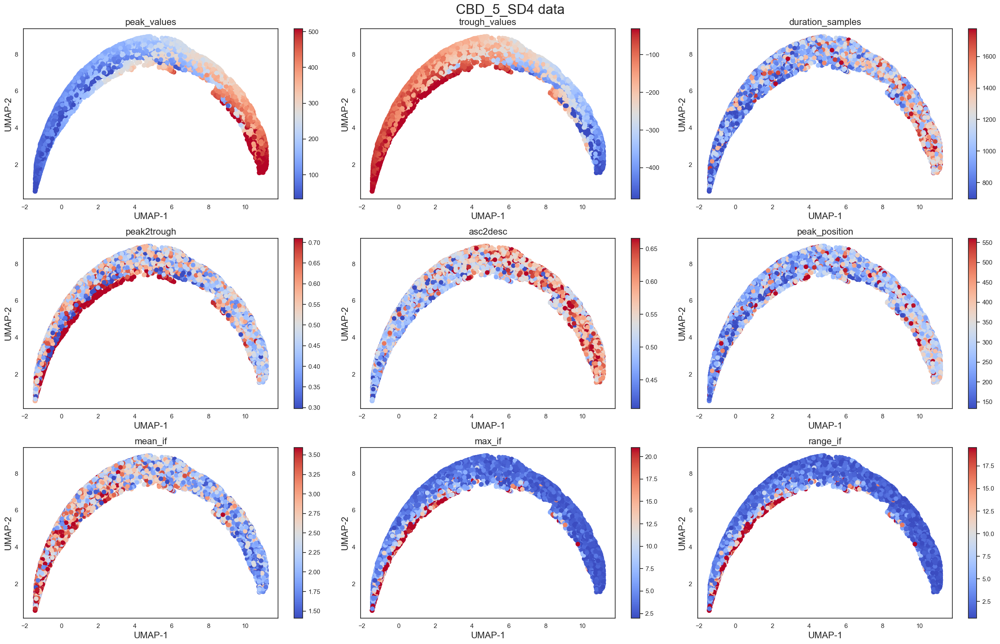

In [218]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','range_if']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,1], c=CBD_all_trials[feature],
            vmin=np.percentile(CBD_all_trials[feature],5),
            vmax=np.percentile(CBD_all_trials[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-2', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("CBD_5_SD4 data", fontsize=24);
f.tight_layout()
plt.savefig('CBD_5_SD4_UMAP1&2.jpg')
plt.savefig('CBD_5_SD4_UMAP1&2.svg')

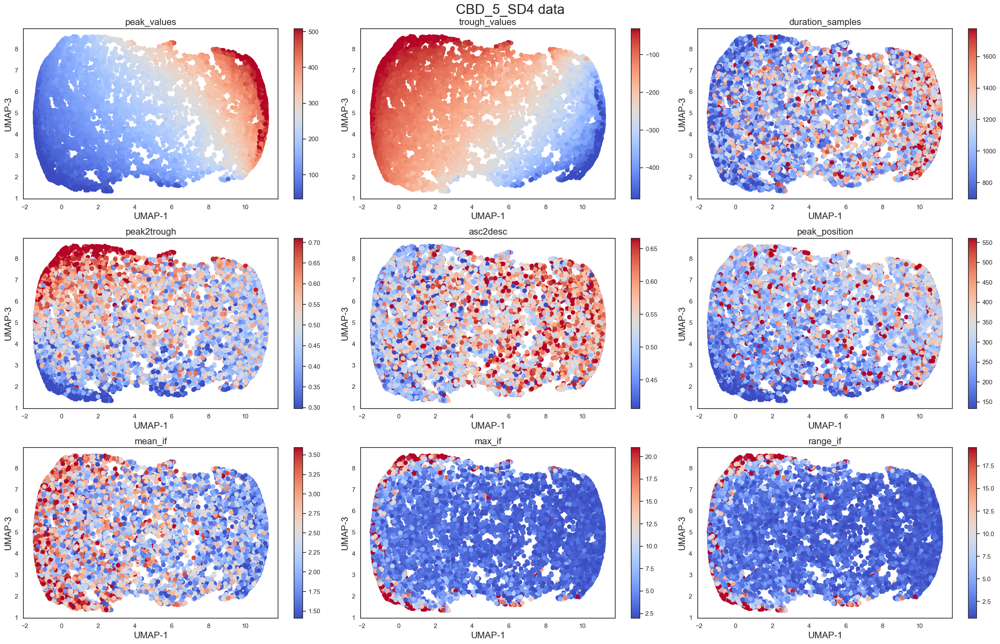

In [219]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','range_if']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,2], c=CBD_all_trials[feature],
            vmin=np.percentile(CBD_all_trials[feature],5),
            vmax=np.percentile(CBD_all_trials[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-3', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("CBD_5_SD4 data", fontsize=24);
f.tight_layout()
plt.savefig('CBD_5_SD4_UMAP1&3.jpg')
plt.savefig('CBD_5_SD4_UMAP1&3.svg')

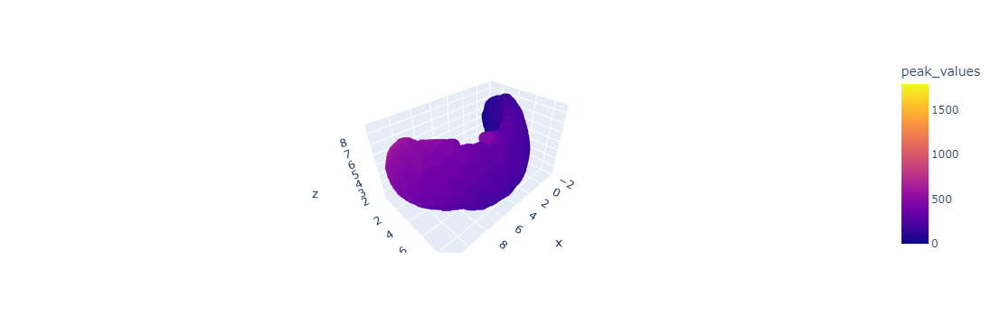

In [203]:
fig = px.scatter_3d(x=emb[:,0], y=emb[:,1], z=emb[:,2],
              color=CBD_all_trials['peak_values'])
fig.update_layout(coloraxis_colorbar_title_text = 'peak_values')
fig.show()

# RGS_13_SD4 Data

In [31]:
path_to_data = './data/RGS_13_SD4/'
data_file = 'Cleaned_Trial1_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-21_11-29-11_Post-Trial1-states.mat'
pfc_data1, sleep_scoring1 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial2_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-21_12-19-45_Post-Trial2-states.mat'
pfc_data2, sleep_scoring2 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial3_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-21_13-11-00_Post-Trial3-states.mat'
pfc_data3, sleep_scoring3 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial4_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-21_14-01-51_Post-Trial4-states.mat'
pfc_data4, sleep_scoring4 = load_mat_data(path_to_data, data_file, states_file)

data_file = 'Cleaned_Trial5_PFC_100_CH63_0.continuous.mat'
states_file = '2019-05-21_14-56-02_Post-trial5-states.mat'
pfc_data5, sleep_scoring5 = load_mat_data(path_to_data, data_file, states_file)

In [32]:
len(pfc_data5)/len(sleep_scoring5)

1000.0896844436243

In [33]:
def get_delta_cycles(pfc_data, sleep_scoring, fs=1000):
    # Get filtered NREM LFP data
    nrem_epochs = np.array(get_all_NREM_epochs(sleep_scoring))
    if len(nrem_epochs) == 0:
        return None
    nrem_filtered_data, nrem_data = get_nrem_filtered(pfc_data, nrem_epochs, fs=fs)

    # Get cycles using IP
    IP, IF, IA = emd.spectra.frequency_transform(nrem_filtered_data, fs, 'hilbert')
    C = emd.cycles.Cycles(IP)
    cycles = get_cycles_with_metrics(C, nrem_filtered_data, IA, IF)
    
    delta_cycle_data = {"fs": fs, 'nrem_epochs': nrem_epochs, 'nrem_filtered_data': nrem_filtered_data,
                       "IP": IP, "IF": IF, "IP": IP, "cycles": cycles}
    return delta_cycle_data

In [34]:
RGS_delta_cycle_data_trial1 = get_delta_cycles(pfc_data1, sleep_scoring1, fs=1000)
RGS_delta_cycle_data_trial2 = get_delta_cycles(pfc_data2, sleep_scoring2, fs=1000)
RGS_delta_cycle_data_trial3 = get_delta_cycles(pfc_data3, sleep_scoring3, fs=1000)
RGS_delta_cycle_data_trial4 = get_delta_cycles(pfc_data4, sleep_scoring4, fs=1000)
RGS_delta_cycle_data_trial5 = get_delta_cycles(pfc_data5, sleep_scoring5, fs=1000)

 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'
 Checking Cycles inputs - trimming singleton from input 'IP'


In [35]:
# metrics1 = RGS_delta_cycle_data_trial1['cycles'].get_metric_dataframe()
metrics2 = RGS_delta_cycle_data_trial2['cycles'].get_metric_dataframe()
metrics3 = RGS_delta_cycle_data_trial3['cycles'].get_metric_dataframe()
metrics4 = RGS_delta_cycle_data_trial4['cycles'].get_metric_dataframe()
metrics5 = RGS_delta_cycle_data_trial5['cycles'].get_metric_dataframe()

RGS_all_trials_metrics = pd.concat([metrics2, metrics3, metrics4, metrics5])
# all_trials_metrics = metrics5

trough = 100
peak = 90
delta_peak = 60

peak_thresh = np.percentile(RGS_all_trials_metrics['peak_values'], peak)
trough_thresh = np.percentile(RGS_all_trials_metrics['trough_values'], trough)
delta_peak_thresh = np.percentile(RGS_all_trials_metrics['peak_values'], delta_peak)

lo_freq_duration = RGS_delta_cycle_data_trial5['fs']/0.1
hi_freq_duration = RGS_delta_cycle_data_trial5['fs']/4

In [38]:
# Apply conditions to get good cycles
conditions_all_cycles = ['is_good==1',
              f'duration_samples<{lo_freq_duration}',
              f'duration_samples>{hi_freq_duration}',
              f'trough_values<={trough_thresh}']

RGS_all_cycles_trial2 = get_cycles_with_conditions(RGS_delta_cycle_data_trial2['cycles'], conditions_all_cycles)
RGS_all_cycles_trial3 = get_cycles_with_conditions(RGS_delta_cycle_data_trial3['cycles'], conditions_all_cycles)
RGS_all_cycles_trial4 = get_cycles_with_conditions(RGS_delta_cycle_data_trial4['cycles'], conditions_all_cycles)
RGS_all_cycles_trial5 = get_cycles_with_conditions(RGS_delta_cycle_data_trial5['cycles'], conditions_all_cycles)

In [41]:
RGS_all_waveforms_trial2, _ = emd.cycles.phase_align(RGS_delta_cycle_data_trial2['IP'], RGS_delta_cycle_data_trial2['nrem_filtered_data'],
                                                            cycles=RGS_all_cycles_trial2.iterate(through='subset'), npoints=100)
RGS_all_waveforms_trial3, _ = emd.cycles.phase_align(RGS_delta_cycle_data_trial3['IP'], RGS_delta_cycle_data_trial3['nrem_filtered_data'],
                                                            cycles=RGS_all_cycles_trial3.iterate(through='subset'), npoints=100)
RGS_all_waveforms_trial4, _ = emd.cycles.phase_align(RGS_delta_cycle_data_trial4['IP'], RGS_delta_cycle_data_trial4['nrem_filtered_data'],
                                                            cycles=RGS_all_cycles_trial4.iterate(through='subset'), npoints=100)
RGS_all_waveforms_trial5, _ = emd.cycles.phase_align(RGS_delta_cycle_data_trial5['IP'], RGS_delta_cycle_data_trial5['nrem_filtered_data'],
                                                            cycles=RGS_all_cycles_trial5.iterate(through='subset'), npoints=100)

RGS_all_waveforms_trial2 = RGS_all_waveforms_trial2.T
RGS_all_waveforms_trial3 = RGS_all_waveforms_trial3.T
RGS_all_waveforms_trial4 = RGS_all_waveforms_trial4.T
RGS_all_waveforms_trial5 = RGS_all_waveforms_trial5.T

 Checking phase_align inputs - trimming singleton from input 'ip'
 Checking phase_align inputs - trimming singleton from input 'ip'
 Checking phase_align inputs - trimming singleton from input 'ip'
 Checking phase_align inputs - trimming singleton from input 'ip'


In [56]:
metrics = RGS_all_cycles_trial2.get_metric_dataframe(subset=True)
RGS_trial2 = pd.concat([metrics, pd.DataFrame(RGS_all_waveforms_trial2)], axis=1)

metrics = RGS_all_cycles_trial3.get_metric_dataframe(subset=True)
RGS_trial3 = pd.concat([metrics, pd.DataFrame(RGS_all_waveforms_trial3)], axis=1)

metrics = RGS_all_cycles_trial4.get_metric_dataframe(subset=True)
RGS_trial4 = pd.concat([metrics, pd.DataFrame(RGS_all_waveforms_trial4)], axis=1)

metrics = RGS_all_cycles_trial5.get_metric_dataframe(subset=True)
RGS_trial5 = pd.concat([metrics, pd.DataFrame(RGS_all_waveforms_trial5)], axis=1)

RGS_all_trials = pd.concat([RGS_trial2, RGS_trial3, RGS_trial4, RGS_trial5])
RGS_all_trials.columns = RGS_all_trials.columns.astype('str')
RGS_all_trials

,index,is_good,duration_samples,peak2trough,asc2desc,max_amp,trough_values,peak_values,mean_if,max_if,...,90,91,92,93,94,95,96,97,98,99
0,1,1,752,0.467879,0.318444,162.700760,-90.794337,119.231415,1.330285,1.893018,...,-72.234987,-67.140451,-61.425726,-55.107613,-48.189491,-40.685555,-32.609221,-23.967431,-14.779024,-5.056965
1,2,1,586,0.524379,0.564095,301.348018,-213.520443,284.095398,1.707182,1.947166,...,-93.200141,-82.760288,-72.311691,-61.926881,-51.659533,-41.575597,-31.733528,-22.191260,-13.002427,-4.223477
2,3,1,458,0.655337,0.640159,205.606605,-193.780923,149.655097,2.185982,3.415153,...,-111.275638,-101.087007,-90.451374,-79.406210,-67.978421,-56.210090,-44.132840,-31.786909,-19.209348,-6.441041
3,4,1,377,0.436975,0.560075,250.656072,-192.705670,239.485709,2.649944,3.381493,...,-72.546403,-63.954501,-55.508108,-47.249549,-39.207770,-31.412483,-23.893981,-16.669299,-9.755752,-3.168640
4,6,1,707,0.593479,0.664906,209.910417,-204.098007,111.299141,1.415532,1.841049,...,-85.903815,-75.407113,-65.045483,-54.905263,-45.071955,-35.627900,-26.650095,-18.217741,-10.403144,-3.280439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2659,5654,1,380,0.493549,0.562040,398.628067,-325.434565,345.655622,2.626306,2.820050,...,-128.941682,-113.990726,-99.207028,-84.662055,-70.424458,-56.554867,-43.106372,-30.127284,-17.659960,-5.743025
2660,5655,1,473,0.496022,0.431285,228.910015,-227.704942,106.462997,2.116245,2.616674,...,-122.132938,-109.563518,-96.714786,-83.670881,-70.521223,-57.346614,-44.236558,-31.269022,-18.527334,-6.085384
2661,5656,1,492,0.600826,0.383936,191.779140,-34.588397,110.607382,2.032666,2.793821,...,-21.486322,-19.695403,-17.790156,-15.771459,-13.640530,-11.397686,-9.045753,-6.587813,-4.027048,-1.365993
2662,5657,1,413,0.507149,0.541995,157.443517,-133.019390,71.894993,2.419600,2.627611,...,-84.475785,-77.005106,-69.105232,-60.808926,-52.151211,-43.174233,-33.915452,-24.425763,-14.750858,-4.939801


In [46]:
RGS_all_waveforms = np.vstack((RGS_all_waveforms_trial2,
                               RGS_all_waveforms_trial3,
                               RGS_all_waveforms_trial4,
                               RGS_all_waveforms_trial5))

## Intrinsic Dimension Estimation

In [48]:
danco = skdim.id.DANCo().fit(RGS_all_waveforms)
danco.dimension_

5.973533437564032

In [49]:
lpca = skdim.id.lPCA().fit_pw(RGS_all_waveforms,
                              n_neighbors = 100,
                              n_jobs = 1)
np.mean(lpca.dimension_pw_)

4.0595779220779225

In [50]:
ID = np.round(np.nanmean(abids(RGS_all_waveforms, 50)))
ID

3.0

In [ ]:
max_embedding_dimension = 15
max_time_delay = 20
stride = 3

embedder = SingleTakensEmbedding(
    parameters_type="search",
    n_jobs=2,
    time_delay=max_time_delay,
    dimension=max_embedding_dimension,
    stride=stride,
)

embedding = embedder.fit_transform(RGS_all_waveforms.ravel())
print(embedder.dimension_)

## UMAP

In [220]:
umap_embedder = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3, metric='euclidean')
embedding = umap_embedder.fit(RGS_all_waveforms)
emb = embedding.embedding_

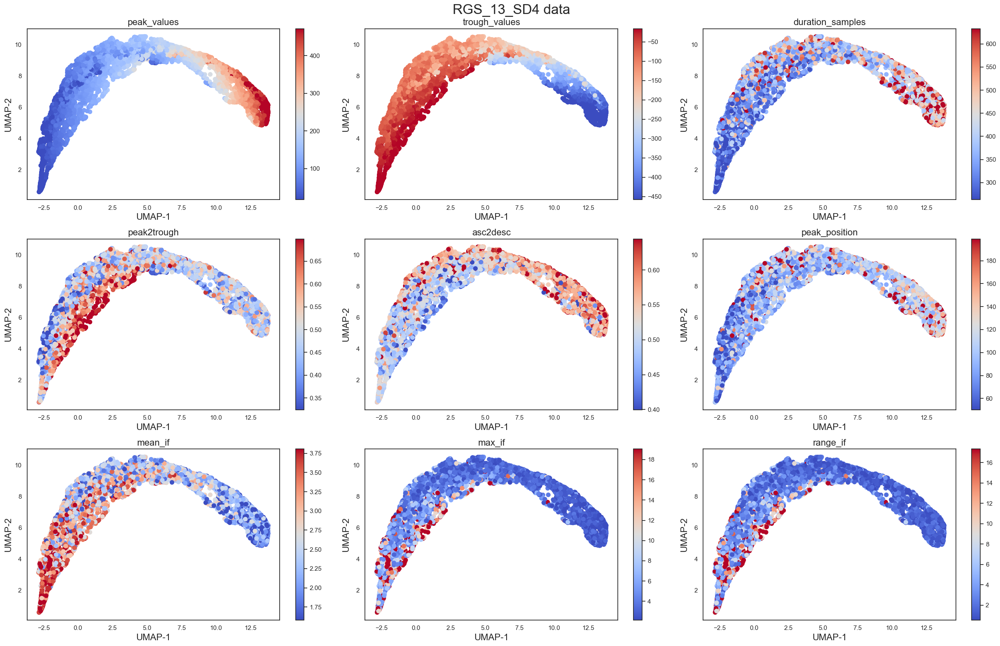

In [221]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','range_if']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,1], c=RGS_all_trials[feature],
            vmin=np.percentile(RGS_all_trials[feature],5),
            vmax=np.percentile(RGS_all_trials[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-2', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("RGS_13_SD4 data", fontsize=24);
f.tight_layout()
plt.savefig('RGS_13_SD4_UMAP1&2.jpg')
plt.savefig('RGS_13_SD4_UMAP1&2.svg')

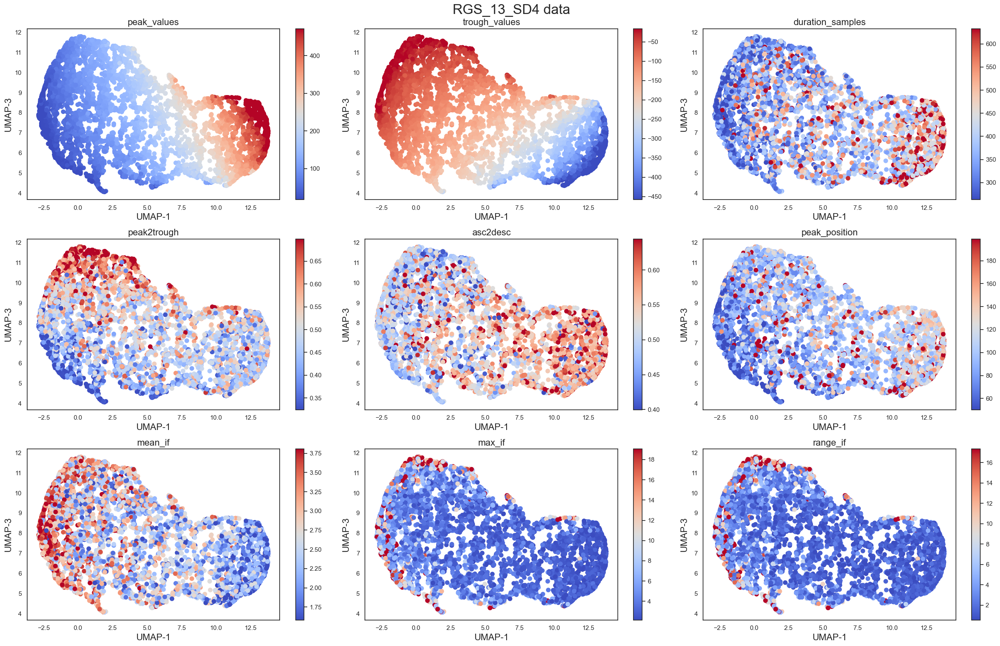

In [222]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','range_if']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,2], c=RGS_all_trials[feature],
            vmin=np.percentile(RGS_all_trials[feature],5),
            vmax=np.percentile(RGS_all_trials[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-3', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("RGS_13_SD4 data", fontsize=24);
f.tight_layout()
plt.savefig('RGS_13_SD4_UMAP1&3.jpg')
plt.savefig('RGS_13_SD4_UMAP1&3.svg')

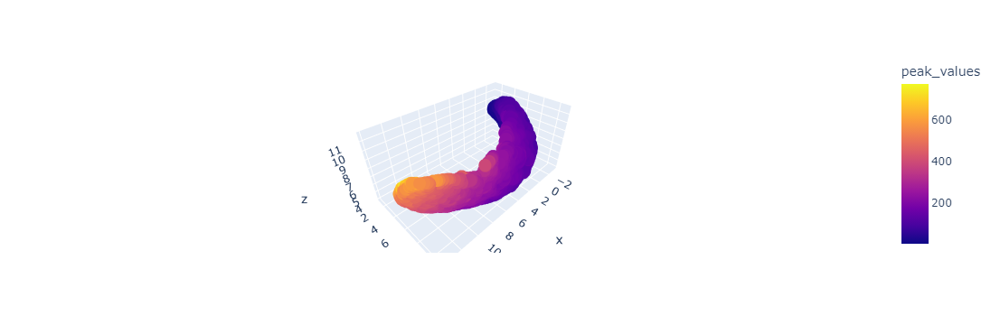

In [59]:
fig = px.scatter_3d(x=emb[:,0], y=emb[:,1], z=emb[:,2],
              color=RGS_all_trials['peak_values'])
fig.update_layout(coloraxis_colorbar_title_text = 'peak_values')
fig.show()

# 2018-07-26_14-20-46_Post-Trial5 Data

In [60]:
path_to_data = "./data/2018-07-26_14-20-46_Post-Trial5/"
data_file = 'Cleaned_PFC_100_CH52_0.continuous.mat'
states_file = '2018-07-26_14-20-46_Post-Trial5-states.mat'
pfc_data, sleep_scoring = load_mat_data(path_to_data, data_file, states_file)

In [61]:
delta_cycle_data = get_delta_cycles(pfc_data, sleep_scoring, fs=1000)

 Checking Cycles inputs - trimming singleton from input 'IP'


In [62]:
metrics = delta_cycle_data['cycles'].get_metric_dataframe()

# metrics = pd.concat([metrics1])
# all_trials_metrics = metrics5

trough = 100
peak = 85
delta_peak = 40

peak_thresh = np.percentile(metrics['peak_values'], peak)
trough_thresh = np.percentile(metrics['trough_values'], trough)
delta_peak_thresh = np.percentile(metrics['peak_values'], delta_peak)

lo_freq_duration = delta_cycle_data['fs']/0.1
hi_freq_duration = delta_cycle_data['fs']/4

In [63]:
# Apply conditions to get good cycles
conditions_all_cycles = ['is_good==1',
              f'duration_samples<{lo_freq_duration}',
              f'duration_samples>{hi_freq_duration}',
              f'trough_values<={trough_thresh}']

all_cycles_trial5 = get_cycles_with_conditions(delta_cycle_data['cycles'], conditions_all_cycles)

In [65]:
all_waveforms_trial5, _ = emd.cycles.phase_align(delta_cycle_data['IP'], delta_cycle_data['nrem_filtered_data'],
                                                            cycles=all_cycles_trial5.iterate(through='subset'), npoints=100)

all_waveforms_trial5 = all_waveforms_trial5.T

 Checking phase_align inputs - trimming singleton from input 'ip'


In [66]:
metrics = all_cycles_trial5.get_metric_dataframe(subset=True)
trial5 = pd.concat([metrics, pd.DataFrame(all_waveforms_trial5)], axis=1)
trial5.columns = trial5.columns.astype('str')
trial5

,index,is_good,duration_samples,peak2trough,asc2desc,max_amp,trough_values,peak_values,mean_if,max_if,...,90,91,92,93,94,95,96,97,98,99
0,4,1,623,0.464307,0.714499,203.784857,-168.019042,115.031281,1.609152,4.684415,...,-27.311612,-23.954266,-20.691159,-17.532454,-14.495047,-11.578216,-8.791173,-6.129110,-3.589250,-1.167331
1,8,1,498,0.479568,0.565421,385.419236,-385.061739,268.741512,2.008000,2.288361,...,-186.770938,-165.587446,-144.279022,-123.034467,-102.046247,-81.508572,-61.624185,-42.581890,-24.587713,-7.841685
2,15,1,832,0.663332,0.512087,577.478296,-464.338443,335.883058,1.201157,1.832108,...,-149.853062,-130.208832,-111.265123,-93.111385,-75.846506,-59.551324,-44.303763,-30.161466,-17.185819,-5.415892
3,18,1,610,0.574026,0.420062,133.552428,-78.893017,132.429358,1.640278,2.271049,...,-33.520843,-29.803321,-26.087542,-22.391079,-18.735620,-15.133679,-11.600937,-8.155046,-4.807146,-1.572369
4,19,1,320,0.830790,0.584002,49.342483,-6.055350,41.143930,3.119468,32.120718,...,-5.907690,-6.018144,-6.055225,-5.976890,-5.746248,-5.318837,-4.652225,-3.712682,-2.468277,-0.904237
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5815,9987,1,409,0.441713,0.570089,287.134725,-218.093062,277.858873,2.447474,3.070739,...,-112.772317,-100.796296,-88.583787,-76.232595,-63.846002,-51.526769,-39.391633,-27.550973,-16.122160,-5.219784
5816,9988,1,783,0.605851,0.726610,487.763041,-282.780497,197.334035,1.277633,2.493442,...,-189.644231,-176.895295,-163.149198,-148.115036,-131.462266,-112.870335,-92.078971,-68.897438,-43.227992,-15.031248
5817,9994,1,354,0.645535,0.519487,382.189910,-76.895386,366.440245,2.819188,6.747123,...,-18.696560,-16.587125,-14.521955,-12.496625,-10.499829,-8.530962,-6.594207,-4.683621,-2.794356,-0.924433
5818,9998,1,472,0.412788,0.545241,619.922038,-619.121028,390.620448,2.120472,2.662690,...,-330.204760,-296.295907,-261.588114,-226.314864,-190.716525,-155.037820,-119.524785,-84.421245,-49.964892,-16.391834


## Intrinsic Dimension Estimation

In [67]:
danco = skdim.id.DANCo().fit(all_waveforms_trial5)
danco.dimension_

5.989686205674235

In [68]:
lpca = skdim.id.lPCA().fit_pw(all_waveforms_trial5,
                              n_neighbors = 100,
                              n_jobs = 1)
np.mean(lpca.dimension_pw_)

4.151030927835052

In [80]:
corr_int = skdim.id.ESS().fit(all_waveforms_trial5)
corr_int.dimension_

3.5938178397761624

In [207]:
ID = np.round(np.nanmean(abids(all_waveforms_trial5, 50)))
ID

4.0

## UMAP

In [223]:
umap_embedder = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=4, metric='euclidean')
embedding = umap_embedder.fit(all_waveforms_trial5)
emb = embedding.embedding_

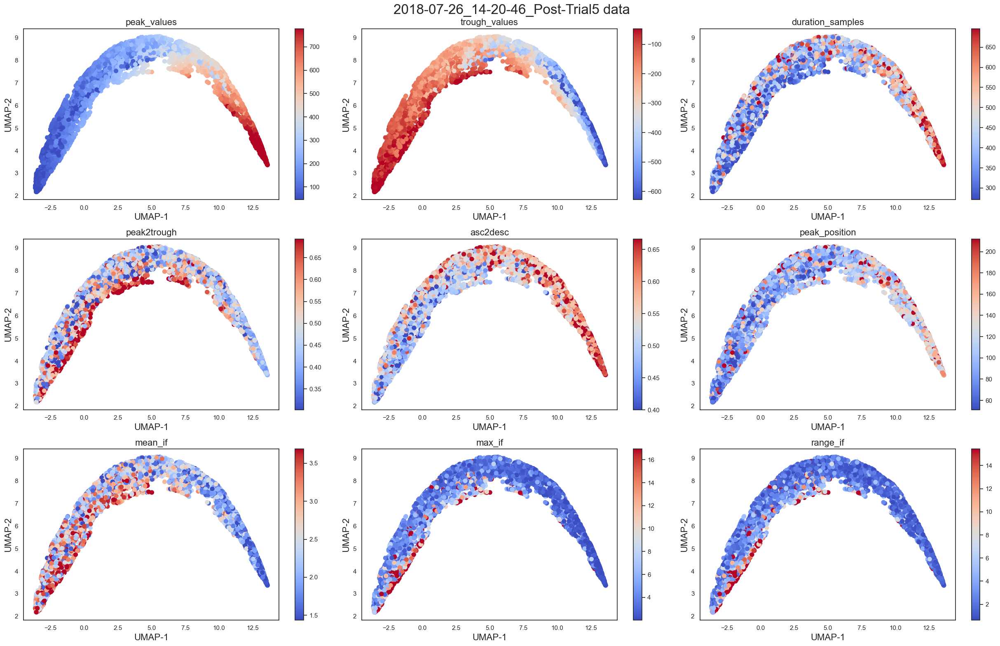

In [224]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','range_if']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,1], c=trial5[feature],
            vmin=np.percentile(trial5[feature],5),
            vmax=np.percentile(trial5[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-2', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("2018-07-26_14-20-46_Post-Trial5 data", fontsize=24);
f.tight_layout()
plt.savefig('2018-07-26_14-20-46_Post-Trial5_UMAP1&2.jpg')
plt.savefig('2018-07-26_14-20-46_Post-Trial5_UMAP1&2.svg')

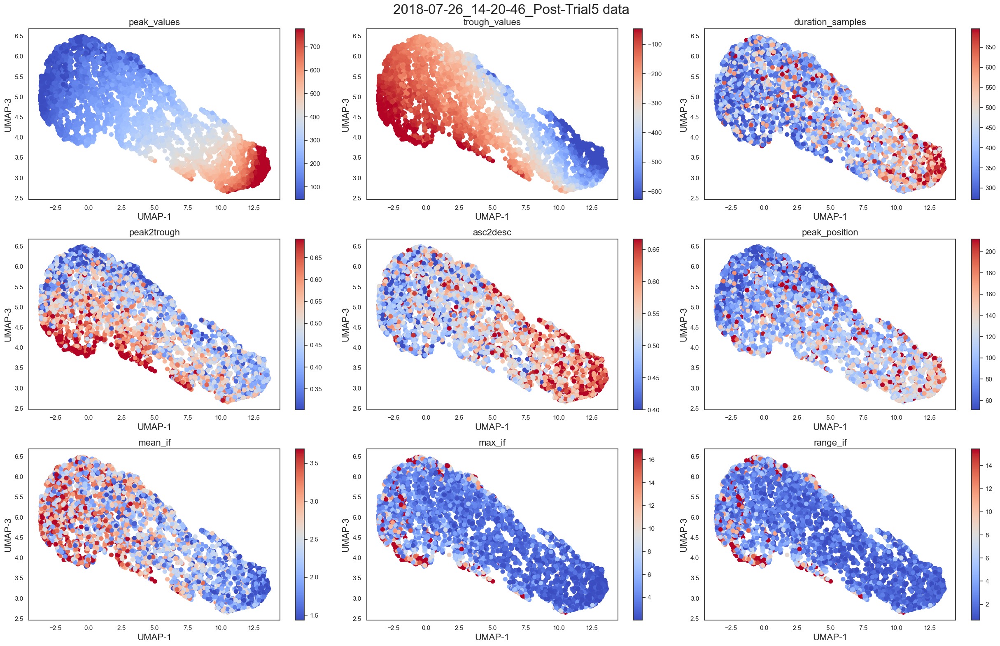

In [225]:
f, ax = plt.subplots(3,3, figsize=(25,16))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','range_if']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,2], c=trial5[feature],
            vmin=np.percentile(trial5[feature],5),
            vmax=np.percentile(trial5[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-3', fontsize=16)
        ax[r,c].set_title(feature, fontsize=16)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle("2018-07-26_14-20-46_Post-Trial5 data", fontsize=24);
f.tight_layout()
plt.savefig('2018-07-26_14-20-46_Post-Trial5_UMAP1&3.jpg')
plt.savefig('2018-07-26_14-20-46_Post-Trial5_UMAP1&3.svg')

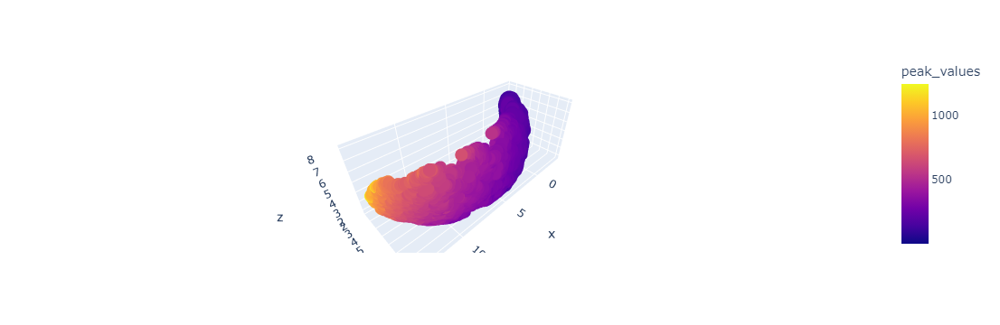

In [75]:
fig = px.scatter_3d(x=emb[:,0], y=emb[:,1], z=emb[:,3],
              color=trial5['peak_values'])
fig.update_layout(coloraxis_colorbar_title_text = 'peak_values')
fig.show()